## Background

The retail industry, and Walmart in particular, relies heavily on operational efficiency, accurate forecasting, and data-driven decision-making to thrive in a competitive landscape. Persistent challenges such as unpredictable demand, suboptimal inventory management, inefficient logistics, and lack of actionable insights into customer behavior often hinder success.

Traditional methods of forecasting and operations management are no longer sufficient to manage the scale and complexity of Walmart's supply chain, inventory, and customer service demands. There is a need for a robust system that incorporates cutting-edge technologies like predictive analytics and machine learning to optimize retail operations.


## Objective

This project proposes the Walmart Supermarket Management System, a technology-driven solution that integrates data mining, predictive analytics, and modern web technologies to enhance retail operations. 


Importing Necessary Libraries

In [75]:
import numpy as np
import pandas as pd  
from pandas.plotting import autocorrelation_plot as auto_corr

import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import iplot
import matplotlib.pyplot as plt
import matplotlib.patches as patches  
%matplotlib inline    
import matplotlib as mpl
import seaborn as sns

from sklearn.model_selection import train_test_split
from statsmodels.tsa.seasonal import seasonal_decompose as season
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn import preprocessing
from sklearn.metrics import r2_score
from sklearn.tree import DecisionTreeRegressor

from math import sqrt
from datetime import datetime
from datetime import timedelta

import itertools
import statsmodels.api as sm
import statsmodels.tsa.api as smt
import statsmodels.formula.api as smf

from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.arima_model import ARIMA

# from pmdarima.utils import decomposed_plot
# from pmdarima.arima import decompose
# from pmdarima import auto_arima


from arch import arch_model
from arch.univariate import ARX, GARCH, StudentsT, Normal

import warnings
warnings.filterwarnings("ignore")



Import Datasets

In [3]:
df_train = pd.read_csv("train.csv")
df_features = pd.read_csv("features.csv")
df_stores = pd.read_csv("stores.csv")
df_test = pd.read_csv("test.csv")

In [4]:
df_train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [5]:
df_train.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [6]:
df_train.shape

(421570, 5)

In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [8]:
df_train.describe()

,Store,Dept,Weekly_Sales
count,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123
std,12.785297,30.492054,22711.183519
min,1.000000,1.000000,-4988.940000
25%,11.000000,18.000000,2079.650000
50%,22.000000,37.000000,7612.030000
75%,33.000000,74.000000,20205.852500
max,45.000000,99.000000,693099.360000


In [9]:
df_train.isnull()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,False,False,False,False,False
1,False,False,False,False,False
2,False,False,False,False,False
3,False,False,False,False,False
4,False,False,False,False,False
...,...,...,...,...,...
421565,False,False,False,False,False
421566,False,False,False,False,False
421567,False,False,False,False,False
421568,False,False,False,False,False


In [10]:
df_train.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [11]:
df_features.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2/5/2010,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2/12/2010,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2/19/2010,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2/26/2010,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,3/5/2010,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [12]:
df_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
dtypes: bool(1), float64(9), int64(1), object(1)
memory usage: 712.0+ KB


In [13]:
df_features.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000


In [14]:
df_features.isnull()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,False,False,False,False,True,True,True,True,True,False,False,False
1,False,False,False,False,True,True,True,True,True,False,False,False
2,False,False,False,False,True,True,True,True,True,False,False,False
3,False,False,False,False,True,True,True,True,True,False,False,False
4,False,False,False,False,True,True,True,True,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
8185,False,False,False,False,False,False,False,False,False,True,True,False
8186,False,False,False,False,False,False,False,False,False,True,True,False
8187,False,False,False,False,False,False,False,False,False,True,True,False
8188,False,False,False,False,False,False,False,False,False,True,True,False


In [15]:
df_features.isnull().sum()

Store              0
Date               0
Temperature        0
Fuel_Price         0
MarkDown1       4158
MarkDown2       5269
MarkDown3       4577
MarkDown4       4726
MarkDown5       4140
CPI              585
Unemployment     585
IsHoliday          0
dtype: int64

In [16]:
df_stores.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [17]:
df_stores.columns

Index(['Store', 'Type', 'Size'], dtype='object')

In [18]:
df_stores.shape

(45, 3)

In [19]:
df_stores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Store   45 non-null     int64 
 1   Type    45 non-null     object
 2   Size    45 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.2+ KB


In [20]:
df_stores.describe()

,Store,Size
count,45.000000,45.000000
mean,23.000000,130287.600000
std,13.133926,63825.271991
min,1.000000,34875.000000
25%,12.000000,70713.000000
50%,23.000000,126512.000000
75%,34.000000,202307.000000
max,45.000000,219622.000000


In [21]:
df_stores.isnull()

,Store,Type,Size
0,False,False,False
1,False,False,False
2,False,False,False
3,False,False,False
4,False,False,False
5,False,False,False
6,False,False,False
7,False,False,False
8,False,False,False
9,False,False,False


In [22]:
df_stores.isnull().sum()

Store    0
Type     0
Size     0
dtype: int64

Stores Type and their Percentage(%)

In [23]:
labels = df_stores["Type"].value_counts()[:10].index
values = df_stores["Type"].value_counts()[:10].values

colors = df_stores["Type"]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo="label+percent", marker=dict(colors=colors))])

fig.show()

Merging Stores and Features Together

In [24]:
df1=pd.merge(df_features,df_stores,on=['Store'])
df1.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size
0,1,2/5/2010,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315
1,1,2/12/2010,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315
2,1,2/19/2010,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315
3,1,2/26/2010,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False,A,151315
4,1,3/5/2010,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False,A,151315


In [25]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 839.9+ KB


In [26]:
df1.columns # Columns in the newly merged Datas.

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday', 'Type', 'Size'],
      dtype='object')

In [27]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 839.9+ KB


In [28]:
df1.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000,8190.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821,130287.600000
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259,63115.971429
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000,34875.000000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000,70713.000000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000,126512.000000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000,202307.000000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000,219622.000000


Visualizing Using the Combine Data Type with the Percentage

In [29]:
labels = df1["Type"].value_counts()[:10].index # Taking the top 10 index
values = df1["Type"].value_counts()[:10].values # Taking the top 10 values

colors = df1["Type"]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo="label+percent", marker=dict(colors=colors))])

fig.show()

Now, lets get the Data info of the (test) dataset

In [30]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115064 entries, 0 to 115063
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Store      115064 non-null  int64 
 1   Dept       115064 non-null  int64 
 2   Date       115064 non-null  object
 3   IsHoliday  115064 non-null  bool  
dtypes: bool(1), int64(2), object(1)
memory usage: 2.7+ MB


> Date is of string type

Visualizing the Top (10) Department in the train dataset along with their percentage(%)

In [31]:
labels = df_train["Dept"].value_counts()[:10].index # Taking the top 10 Index
values = df_train["Dept"].value_counts()[:10].values # Taking the top 10 values

colors = df_train["Dept"]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo="label+percent", marker=dict(colors=colors))])

fig.show()

Visualizing the Top (10) Store in the Train Dataset with their percentage (%) 

In [32]:
labels = df_train["Store"].value_counts()[:10].index # Taking the top 10 index
values = df_train["Store"].value_counts()[:10].values # Taking the top 10 values

colors = df_train["Store"]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo="label+percent", marker=dict(colors=colors))])

fig.show()

Visualizing IsHoliday data

In [33]:
labels = df_train["IsHoliday"].value_counts().index # Taking the all index
values = df_train["IsHoliday"].value_counts().values # Taking the all values

colors = df_train["IsHoliday"]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo="label+percent", marker=dict(colors=colors))])

fig.show()

It shows that 93% is of Holidays.

In [34]:
df_test.columns # columns in test

Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')

In [35]:
df_test.describe()

,Store,Dept
count,115064.000000,115064.000000
mean,22.238207,44.339524
std,12.809930,30.656410
min,1.000000,1.000000
25%,11.000000,18.000000
50%,22.000000,37.000000
75%,33.000000,74.000000
max,45.000000,99.000000


In [36]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [37]:
df1["Date"] = pd.to_datetime(df1["Date"])
df_train["Date"] = pd.to_datetime(df_train["Date"])
df_test["Date"] = pd.to_datetime(df_test["Date"])

In [38]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   Store         421570 non-null  int64         
 1   Dept          421570 non-null  int64         
 2   Date          421570 non-null  datetime64[ns]
 3   Weekly_Sales  421570 non-null  float64       
 4   IsHoliday     421570 non-null  bool          
dtypes: bool(1), datetime64[ns](1), float64(1), int64(2)
memory usage: 13.3 MB


In [39]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         8190 non-null   int64         
 1   Date          8190 non-null   datetime64[ns]
 2   Temperature   8190 non-null   float64       
 3   Fuel_Price    8190 non-null   float64       
 4   MarkDown1     4032 non-null   float64       
 5   MarkDown2     2921 non-null   float64       
 6   MarkDown3     3613 non-null   float64       
 7   MarkDown4     3464 non-null   float64       
 8   MarkDown5     4050 non-null   float64       
 9   CPI           7605 non-null   float64       
 10  Unemployment  7605 non-null   float64       
 11  IsHoliday     8190 non-null   bool          
 12  Type          8190 non-null   object        
 13  Size          8190 non-null   int64         
dtypes: bool(1), datetime64[ns](1), float64(9), int64(2), object(1)
memory usage: 839.9+ KB


In [40]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115064 entries, 0 to 115063
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Store      115064 non-null  int64         
 1   Dept       115064 non-null  int64         
 2   Date       115064 non-null  datetime64[ns]
 3   IsHoliday  115064 non-null  bool          
dtypes: bool(1), datetime64[ns](1), int64(2)
memory usage: 2.7 MB


In [41]:
df1["Week"] = df1.Date.dt.isocalendar().week # for the week data
df1["Year"] = df1.Date.dt.year # for the year data

In [42]:
# Merging with the df_train
train_merge = df_train.merge(df1, how = "inner", on = ["Store", "Date", "IsHoliday"]).reset_index(drop = True)

In [43]:
# Merging with df_test
test_merge = df_test.merge(df1, how = "inner", on = ["Store", "Date", "IsHoliday"]).sort_values(by = ["Store", "Dept", "Date"]).reset_index(drop = True)

In [44]:
def scatter(train_merge, column):
    plt.figure()
    plt.scatter(train_merge[column], train_merge["Weekly_Sales"])
    plt.ylabel("Weekly_Sales")
    plt.xlabel(column)

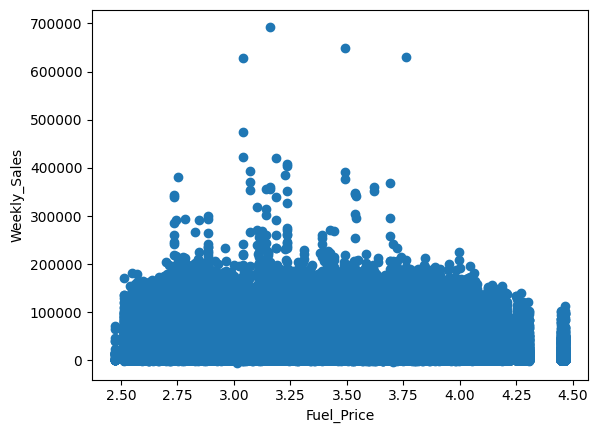

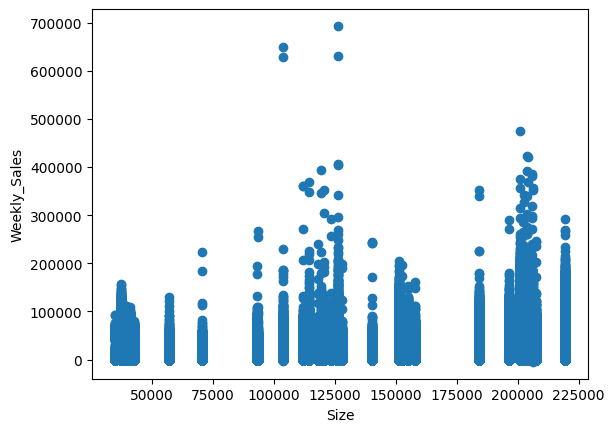

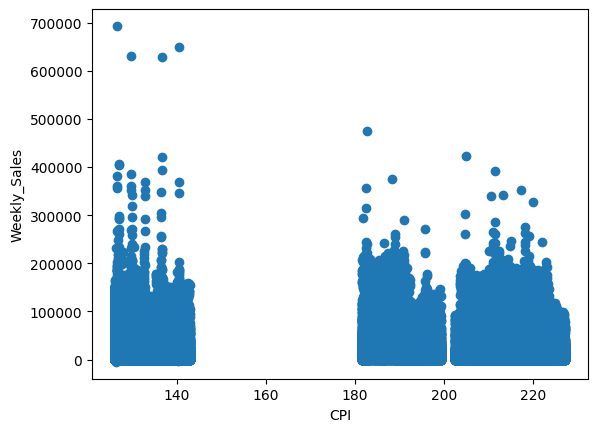

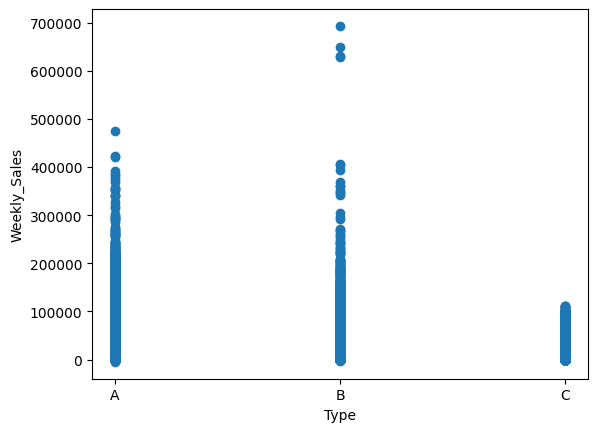

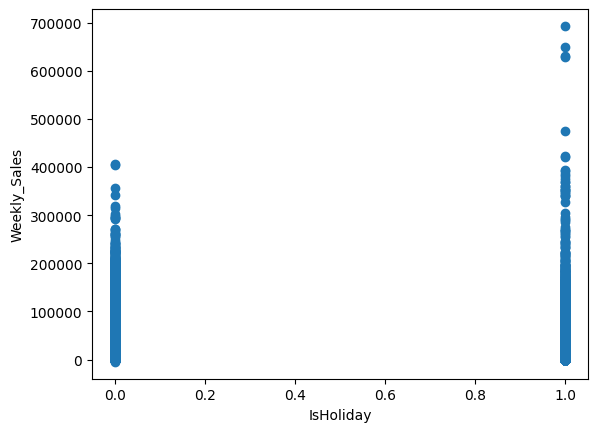

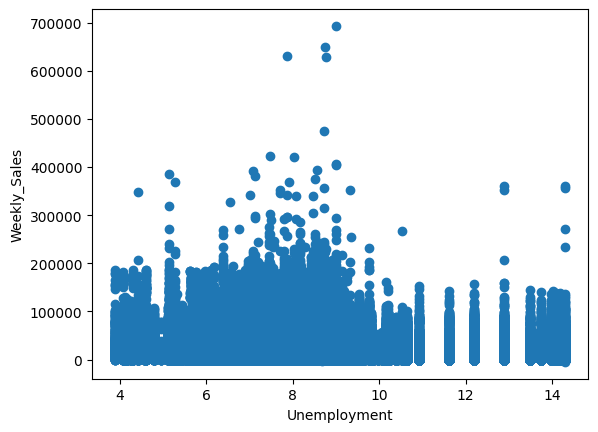

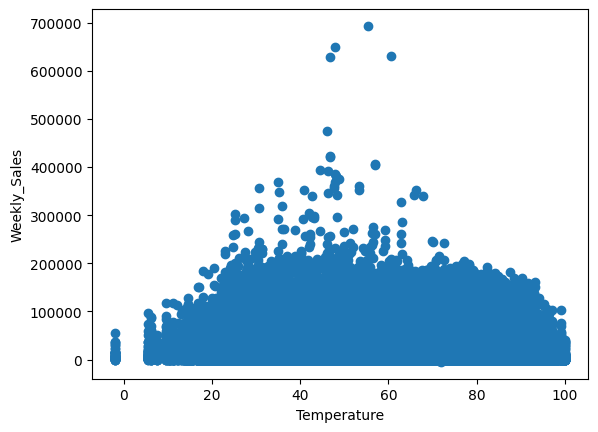

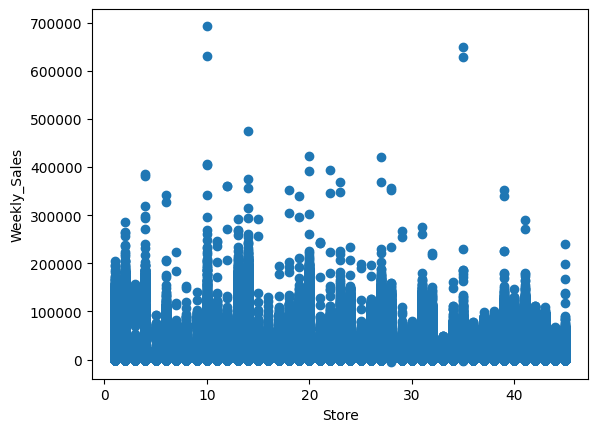

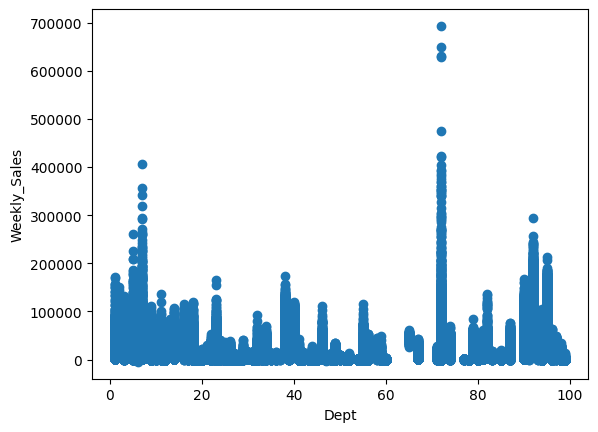

In [45]:
scatter(train_merge, "Fuel_Price")
scatter(train_merge, "Size")
scatter(train_merge, "CPI")
scatter(train_merge, "Type")
scatter(train_merge, "IsHoliday")
scatter(train_merge, "Unemployment")
scatter(train_merge, "Temperature")
scatter(train_merge, "Store")
scatter(train_merge, "Dept")

### Correlation Matrix

Let's have a look at the Average Weekly Sales per Year and find out if there is any other holiday peak sales that were not considered by "IsHoliday" filed.

<Axes: xlabel='Week'>

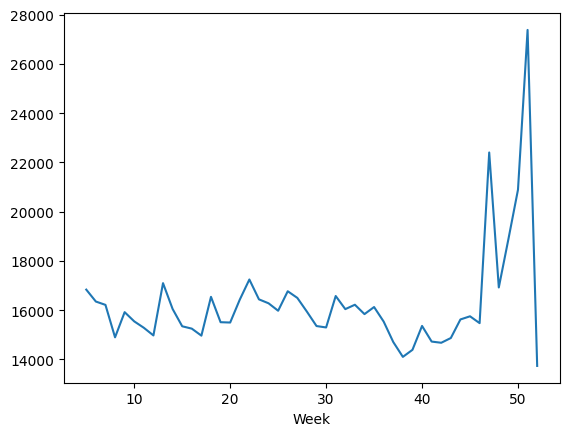

In [46]:
# Average Weekly Sales for the year 2010
weekly_sales_2010 = (train_merge[train_merge["Year"] == 2010].groupby("Week")["Weekly_Sales"].mean())

sns.lineplot(x = weekly_sales_2010.index, y = weekly_sales_2010.values) # for plotting the lineplot

<Axes: xlabel='Week'>

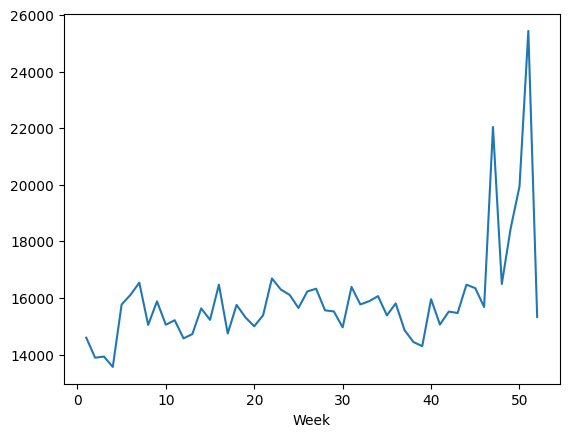

In [47]:
# Average Weekly Sales for the year 2011
weekly_sales_2011 = (train_merge[train_merge["Year"] == 2011].groupby("Week")["Weekly_Sales"].mean())

sns.lineplot(x = weekly_sales_2011.index, y = weekly_sales_2011.values) # for plotting the lineplot

<Axes: xlabel='Week'>

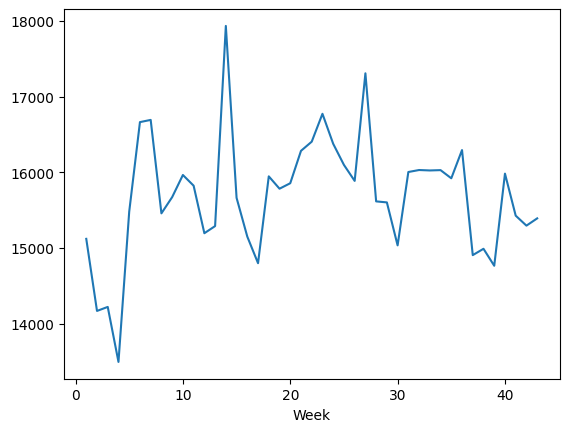

In [48]:
# Average Weekly Sales for the year 2012
weekly_sales_2012 = (train_merge[train_merge["Year"] == 2012].groupby("Week")["Weekly_Sales"].mean())

sns.lineplot(x = weekly_sales_2012.index, y = weekly_sales_2012.values) # for plotting the lineplot

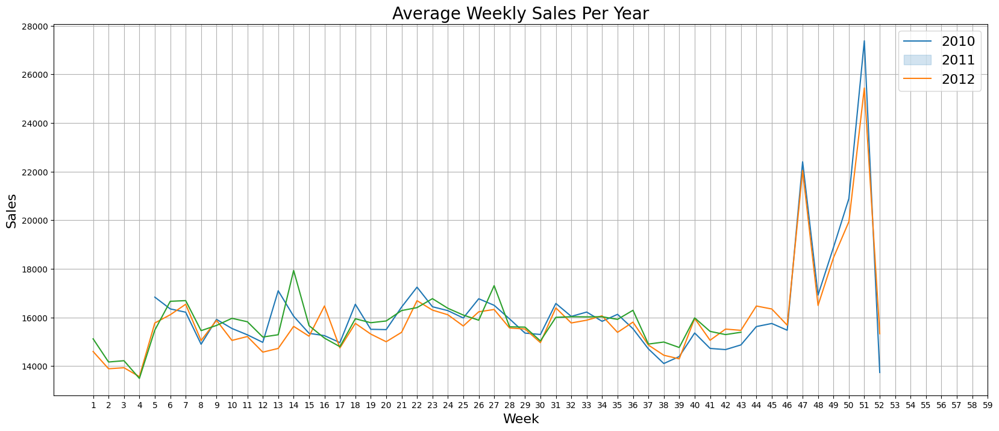

In [49]:
# Plotting the above three plot together
plt.figure(figsize = (20,8))
sns.lineplot(x = weekly_sales_2010.index, y = weekly_sales_2010.values)
sns.lineplot(x = weekly_sales_2011.index, y = weekly_sales_2011.values)
sns.lineplot(x = weekly_sales_2012.index, y = weekly_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1,60, step =1))
plt.legend(["2010", "2011", "2012"], loc = "best", fontsize = 16)
plt.title("Average Weekly Sales Per Year", fontsize = 20)
plt.ylabel("Sales", fontsize = 16)
plt.xlabel("Week", fontsize = 16)
plt.show()

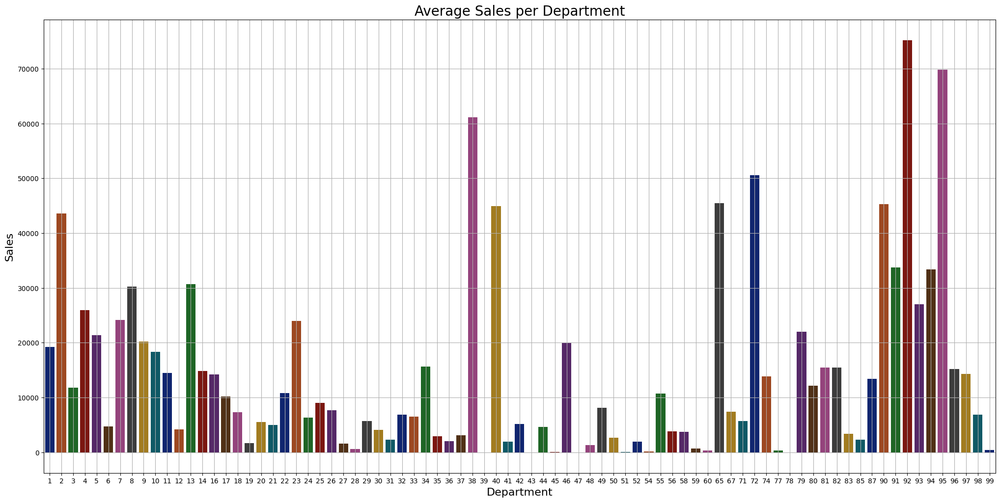

In [50]:
# Average Sales per Department

weekly_sales = train_merge["Weekly_Sales"].groupby(train_merge["Dept"]).mean()
plt.figure(figsize = (25,12))
sns.barplot(x = weekly_sales.index, y = weekly_sales.values, palette = "dark")
plt.grid()
plt.title("Average Sales per Department", fontsize = 20)
plt.xlabel("Department", fontsize = 16)
plt.ylabel("Sales", fontsize = 16)
plt.show()

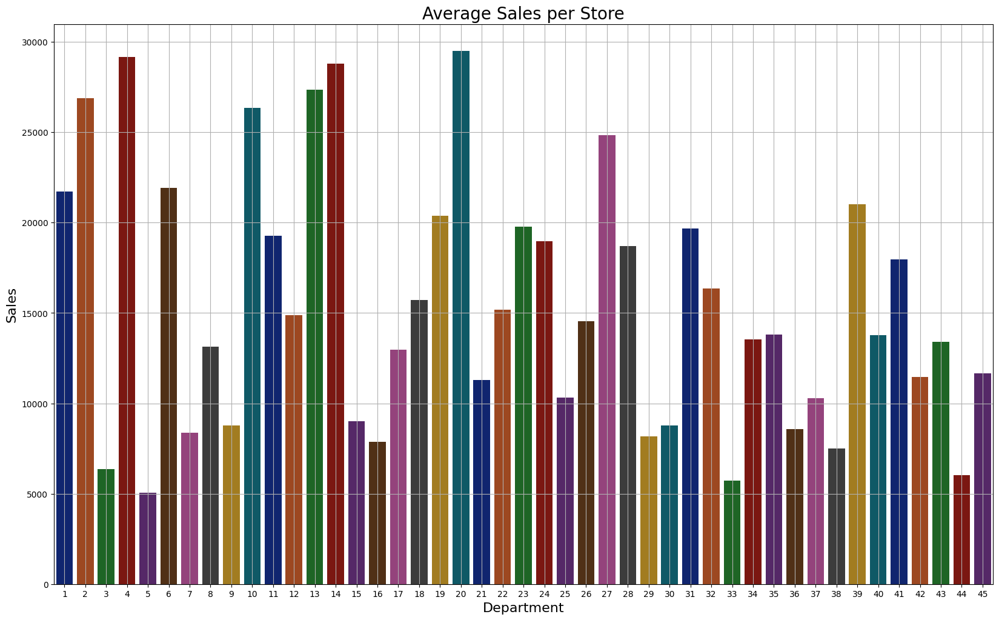

In [51]:
# Average Sales per Store

weekly_sales = train_merge["Weekly_Sales"].groupby(train_merge["Store"]).mean()
plt.figure(figsize = (20,12))
sns.barplot(x = weekly_sales.index, y = weekly_sales.values, palette = "dark")
plt.grid()
plt.title("Average Sales per Store", fontsize = 20)
plt.xlabel("Department", fontsize = 16)
plt.ylabel("Sales", fontsize = 16)
plt.show()

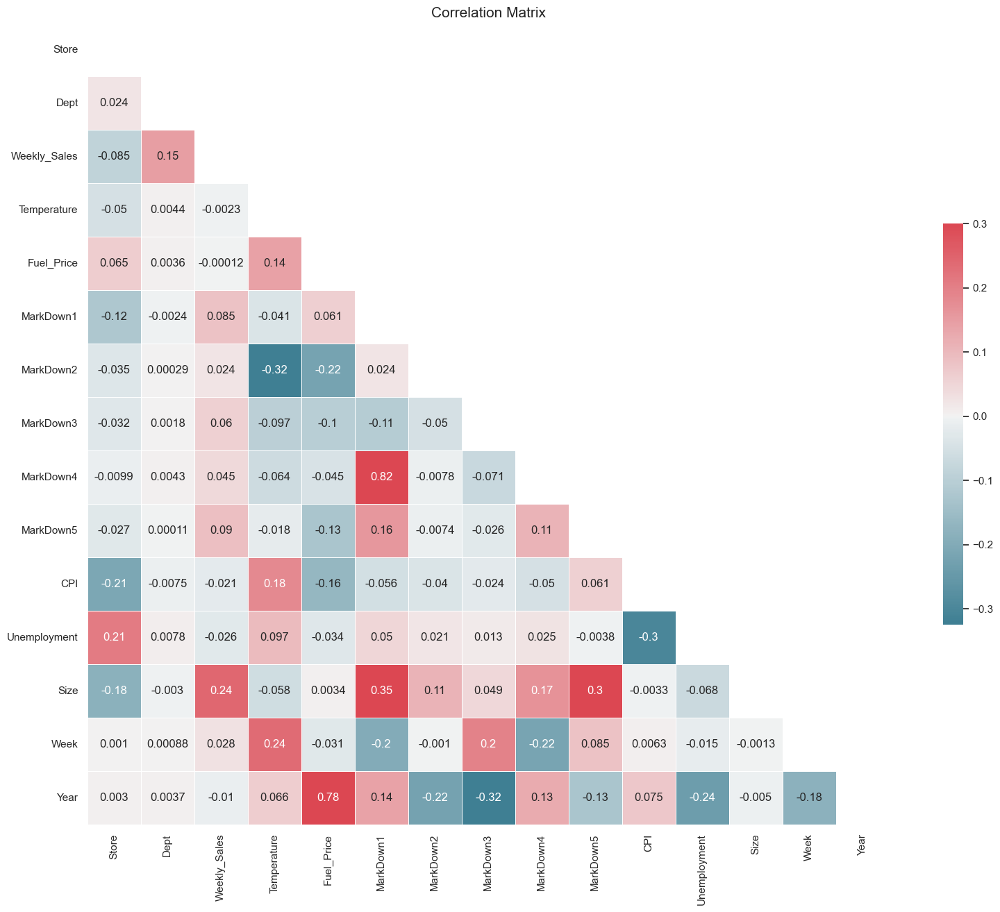

In [52]:
sns.set(style = "white")

corr = train_merge.select_dtypes(include=[np.number]).corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize = (20, 15))

cmap = sns.diverging_palette(220, 10, as_cmap = True)

plt.title("Correlation Matrix", fontsize = 15)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=0.3, center=0, square=True, linewidths=0.5, cbar_kws={"shrink": 0.5}, annot=True)

plt.show()

In [53]:
# Dropping down variables that have weak correlation

train_merge = train_merge.drop(columns=["Fuel_Price", "MarkDown1", "MarkDown2", "MarkDown3", "MarkDown4", "MarkDown5"])
test_merge = test_merge.drop(columns=["Fuel_Price", "MarkDown1", "MarkDown2", "MarkDown3", "MarkDown4", "MarkDown5"])

In [54]:
train_merge.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Temperature,CPI,Unemployment,Type,Size,Week,Year
0,1,1,2010-02-05,24924.50,False,42.31,211.096358,8.106,A,151315,5,2010
1,1,1,2010-02-12,46039.49,True,38.51,211.242170,8.106,A,151315,6,2010
2,1,1,2010-02-19,41595.55,False,39.93,211.289143,8.106,A,151315,7,2010
3,1,1,2010-02-26,19403.54,False,46.63,211.319643,8.106,A,151315,8,2010
4,1,1,2010-03-05,21827.90,False,46.50,211.350143,8.106,A,151315,9,2010


In [55]:
test_merge.head()

,Store,Dept,Date,IsHoliday,Temperature,CPI,Unemployment,Type,Size,Week,Year
0,1,1,2012-11-02,False,55.32,223.462779,6.573,A,151315,44,2012
1,1,1,2012-11-09,False,61.24,223.481307,6.573,A,151315,45,2012
2,1,1,2012-11-16,False,52.92,223.512911,6.573,A,151315,46,2012
3,1,1,2012-11-23,True,56.23,223.561947,6.573,A,151315,47,2012
4,1,1,2012-11-30,False,52.34,223.610984,6.573,A,151315,48,2012


In [56]:
# Counting the number of unique values
df_train['Dept'].nunique()

81

In [57]:
# Counting the number of unique values
df_train['Store'].nunique()

45

In [58]:
# Getting the columns in the train_merge
train_merge.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'CPI', 'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [59]:
# Getting the columns in the test_merge
test_merge.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday', 'Temperature', 'CPI',
       'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

Dividing the data into Train and Test

In [60]:
# Select the values to be taken in the X and y
X = train_merge[['Store', 'Dept', 'IsHoliday', 'Week', 'Year']]
y = train_merge['Weekly_Sales']

### Model Building

In [61]:
# Splitting the data into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [62]:
# Performing GridSearchCV on Ridge Regression
params = {'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
ridge_regressor = GridSearchCV(Ridge(), params, cv=7, scoring='neg_mean_absolute_error', n_jobs = -1)
ridge_regressor.fit(X_train, y_train)

GridSearchCV(cv=7, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [63]:
# Predicting Train and test results
y_train_pred = ridge_regressor.predict(X_train)
y_test_pred = ridge_regressor.predict(X_test)

In [67]:
print("Train Results for Ridge Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared: ", r2_score(y_train.values, y_train_pred))

Train Results for Ridge Regressor Model:
Root Mean Squared Error: 22323.745596207023
R-squared:  0.03068967540932488


In [68]:
print("Train Results for Ridge Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared: ", r2_score(y_test.values,y_test_pred))

Train Results for Ridge Regressor Model:
Root Mean Squared Error: 22445.196261131397
R-squared:  0.030601040753976072


In [71]:
# Performing GridSearchCV on Lasso Regression
params = {'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
lasso_regressor = GridSearchCV(Lasso(), params, cv=15, scoring='neg_mean_absolute_error', n_jobs = -1)
lasso_regressor.fit(X_train, y_train)

GridSearchCV(cv=15, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [72]:
# Predicting Train and test results
y_train_pred = lasso_regressor.predict(X_train)
y_test_pred = lasso_regressor.predict(X_test)

In [73]:
print("Train Results for Lasso Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared: ", r2_score(y_train.values, y_train_pred))

Train Results for Lasso Regressor Model:
Root Mean Squared Error: 22350.106570063916
R-squared:  0.02839910544006119


In [74]:
print("Train Results for Lasso Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared: ", r2_score(y_test.values,y_test_pred))

Train Results for Lasso Regressor Model:
Root Mean Squared Error: 22474.12302381175
R-squared:  0.02810076025550501


In [77]:
# Performing GridSearchCV on Decision Tree Regression
depth = list(range(3,30))
param_grid = dict(max_depth = depth)
tree = GridSearchCV(DecisionTreeRegressor(), param_grid, cv= 10)
tree.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,
                                       15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                       25, 26, 27, 28, 29]})

In [78]:
# Predicting Train and test results
y_train_pred = tree.predict(X_train)
y_test_pred = tree.predict(X_test)

In [79]:
print("Train Results for Decision Tree Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared: ", r2_score(y_train.values, y_train_pred))

Train Results for Decision Tree Regressor Model:
Root Mean Squared Error: 1349.0095414173854
R-squared:  0.996460362787388


In [84]:
print("Train Results for Decision Tree Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared: ", r2_score(y_test.values,y_test_pred))

Train Results for Decision Tree Regressor Model:
Root Mean Squared Error: 4994.491434409396
R-squared:  0.952000326864953


In [85]:
# Performing RandomSearchCV on Random Forest Regression
tuned_params = {'n_estimators': [100, 200], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4]}
random_regressor = RandomizedSearchCV(RandomForestRegressor(), tuned_params, n_iter= 3, scoring= "neg_mean_absolute_error", n_jobs=-1, refit=True, return_train_score=False, cv=3, verbose=0)
random_regressor.fit(X_train, y_train)

RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_iter=3, n_jobs=-1,
                   param_distributions={'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200]},
                   scoring='neg_mean_absolute_error')

In [86]:
# Predicting Train and test results
y_train_pred = random_regressor.predict(X_train)
y_test_pred = random_regressor.predict(X_test)

In [87]:
print("Train Results for Random Forest Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared: ", r2_score(y_train.values, y_train_pred))

Train Results for Random Forest Regressor Model:
Root Mean Squared Error: 2412.7567397861626
R-squared:  0.9886771492095792


In [88]:
print("Train Results for Random Forest Regressor Model:")
print("Root Mean Squared Error:", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared: ", r2_score(y_test.values,y_test_pred))

Train Results for Random Forest Regressor Model:
Root Mean Squared Error: 4349.668408040723
R-squared:  0.9635944132303841


### With the above implementation, it is possible to forecast the prediction of the Walmart Stores